# Dataset Preparation

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
!kaggle datasets download -d zaidpy/oral-cancer-dataset

Dataset URL: https://www.kaggle.com/datasets/zaidpy/oral-cancer-dataset
License(s): apache-2.0
 99% 313M/315M [00:06<00:00, 60.8MB/s]
100% 315M/315M [00:06<00:00, 52.2MB/s]


In [ ]:
import zipfile
import os

# Unzip the dataset
with zipfile.ZipFile('/content/oral-cancer-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('oral_dataset')

# Check the extracted files
os.listdir('oral_dataset')

['Oral cancer Dataset 2.0', 'Oral Cancer']

# Exploring the images

In [ ]:
import os
import pandas as pd
from PIL import Image

# Set the paths to your cancerous and non-cancerous image folders
cancer_path = "/content/oral_dataset/Oral cancer Dataset 2.0/OC Dataset kaggle new/CANCER"
non_cancer_path = "/content/oral_dataset/Oral cancer Dataset 2.0/OC Dataset kaggle new/NON CANCER"

# Initialize an empty list to store file paths and labels
data = []

# Function to check if an image is corrupted
def is_valid_image(image_path):
    try:
        img = Image.open(image_path)
        img.verify()  # Verify that the file is not corrupted
        return True
    except (IOError, SyntaxError):
        print(f"Corrupted image found: {os.path.basename(image_path)}")
        return False

# Explore the cancerous images directory and add valid paths with label 1
for filename in os.listdir(cancer_path):
    if filename.endswith((".jpg", ".jpeg", ".png")):
        image_path = os.path.join(cancer_path, filename)
        if is_valid_image(image_path):
            data.append([image_path, 1])

# Explore the non-cancerous images directory and add valid paths with label 0
for filename in os.listdir(non_cancer_path):
    if filename.endswith((".jpg", ".jpeg", ".png")):
        image_path = os.path.join(non_cancer_path, filename)
        if is_valid_image(image_path):
            data.append([image_path, 0])

# Convert the list to a pandas DataFrame
df = pd.DataFrame(data, columns=["image_path", "label"])

# Save the dataframe to a CSV file for future use if needed
df.to_csv("/content/image_data_clean.csv", index=False)

Corrupted image found: 328.jpeg
Corrupted image found: 317.jpeg
Corrupted image found: 455.jpeg
Corrupted image found: 101.jpeg
Corrupted image found: 273.jpeg
Corrupted image found: 407.jpeg
Corrupted image found: 485.jpeg
Corrupted image found: 200.jpeg
Corrupted image found: 450.jpeg
Corrupted image found: 481.jpeg


In [ ]:
df.tail()

,image_path,label
935,/content/oral_dataset/Oral cancer Dataset 2.0/...,0
936,/content/oral_dataset/Oral cancer Dataset 2.0/...,0
937,/content/oral_dataset/Oral cancer Dataset 2.0/...,0
938,/content/oral_dataset/Oral cancer Dataset 2.0/...,0
939,/content/oral_dataset/Oral cancer Dataset 2.0/...,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 940 entries, 0 to 939
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  940 non-null    object
 1   label       940 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 14.8+ KB


In [ ]:
df['label'].value_counts()

,count
label,
1,490
0,450


In [ ]:
import torch
from torch.utils.data import Dataset
import pandas as pd
from torchvision import transforms
from PIL import Image
import os
import random

# Custom Dataset class to handle images and apply augmentations
class OralCancerDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        # Get image path and label from dataframe
        img_path = self.dataframe.iloc[idx, 0]
        label = self.dataframe.iloc[idx, 1]

        # Open the image
        image = Image.open(img_path).convert('RGB')

        return image, label

# Define augmentation transformations
augmentation_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(),            # Randomly flip horizontally
    transforms.RandomVerticalFlip(),              # Randomly flip vertically
    transforms.RandomRotation(20),                # Randomly rotate within 20 degrees
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2), # Adjust brightness/contrast
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),  # Randomly crop and resize
    transforms.RandomAffine(degrees=15, shear=10),        # Apply random affine transform
    transforms.GaussianBlur(3),                          # Apply slight Gaussian blur
    transforms.ToTensor(),                               # Convert to tensor
])

# Function to save augmented images and create a new dataframe
def save_augmented_images_and_create_df(dataset, output_dir, augment_times=1):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # New lists to store the paths and labels of augmented and original images
    new_image_paths = []
    new_labels = []

    # Generate random indices to augment 50% of the images
    num_images_to_augment = len(dataset) // 2
    indices_to_augment = random.sample(range(len(dataset)), num_images_to_augment)

    for i in range(len(dataset)):
        img, label = dataset[i]
        img_label = "cancer" if label == 1 else "non_cancer"

        # Save original image
        img_save_path = os.path.join(output_dir, f"{img_label}_{i}_original.png")
        img.save(img_save_path)

        # Add original image path and label to lists
        new_image_paths.append(img_save_path)
        new_labels.append(label)

        if i in indices_to_augment:
            # Apply augmentation and save augmented images
            for j in range(augment_times):
                augmented_img = augmentation_transforms(img)

                # Save augmented image
                img_save_path_aug = os.path.join(output_dir, f"{img_label}_{i}_aug_{j}.png")
                img_pil = transforms.ToPILImage()(augmented_img)  # Convert tensor back to PIL image
                img_pil.save(img_save_path_aug)

                # Add augmented image path and label to lists
                new_image_paths.append(img_save_path_aug)
                new_labels.append(label)

    # Create a new dataframe with the updated image paths and labels
    new_df = pd.DataFrame({'image_path': new_image_paths, 'label': new_labels})

    return new_df

# Instantiate the dataset
dataset = OralCancerDataset(dataframe=df)

# Specify the output directory for the augmented images
output_directory = "/content/augmented_images"

# Save augmented images and get the new dataframe
new_df = save_augmented_images_and_create_df(dataset, output_directory, augment_times=5)

# Save the new dataframe to a CSV file if needed
new_df.to_csv('/content/new_augmented_dataset.csv', index=False)

# To access the new dataframe in Python, simply use the variable 'new_df'
print(new_df.head())  # Display the first few rows of the new dataframe

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:1054: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


                                        image_path  label
0  /content/augmented_images/cancer_0_original.png      1
1  /content/augmented_images/cancer_1_original.png      1
2  /content/augmented_images/cancer_2_original.png      1
3  /content/augmented_images/cancer_3_original.png      1
4     /content/augmented_images/cancer_3_aug_0.png      1


In [ ]:
new_df['label'].value_counts()

,count
label,
1,1715
0,1575


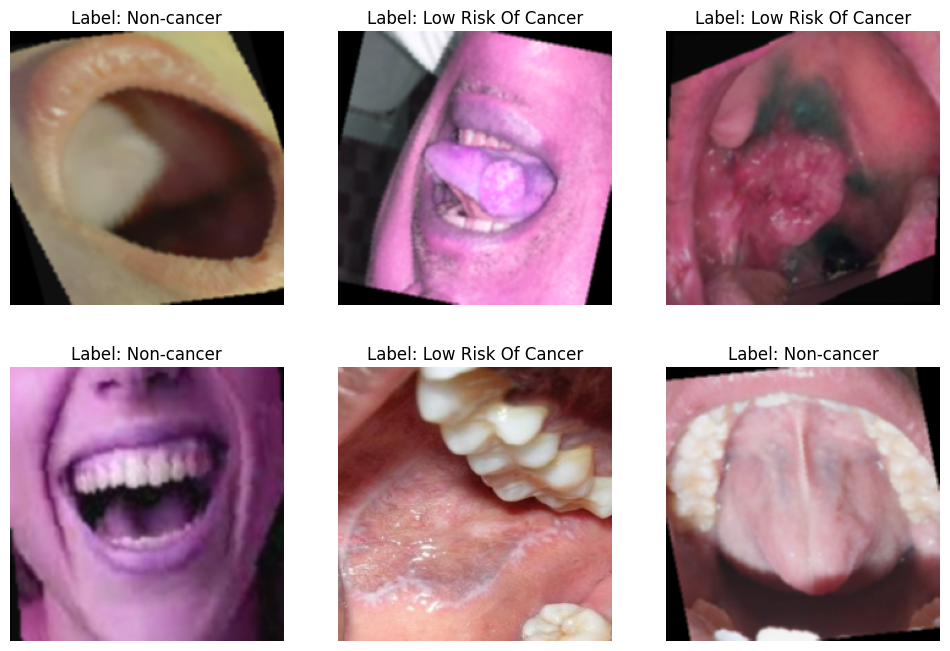

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import numpy as np
import pandas as pd
import os
from torchvision import transforms
import matplotlib.pyplot as plt

# Load the new dataframe with image paths and labels
new_df = pd.read_csv('/content/new_augmented_dataset.csv')

# Custom Dataset class to load images from the dataframe
class AugmentedOralCancerDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        # Get image path and label from the dataframe
        img_path = self.dataframe.iloc[idx, 0]
        label = self.dataframe.iloc[idx, 1]

        # Open the image
        image = Image.open(img_path).convert('RGB')

        # Apply transformations (if any)
        if self.transform:
            image = self.transform(image)

        return image, label

# Define any necessary transformations for the images
image_transforms = transforms.Compose([
    transforms.Resize((224, 224)),    # Resize all images to 224x224
    transforms.ToTensor(),            # Convert the image to PyTorch Tensor
])

# Instantiate the dataset with the new dataframe and transformations
augmented_dataset = AugmentedOralCancerDataset(dataframe=new_df, transform=image_transforms)

# Calculate the number of samples for each dataset
total_images = len(augmented_dataset)
train_size = int(0.7 * total_images)
val_size = int(0.15 * total_images)
test_size = total_images - train_size - val_size  # Remaining samples for the test set

# Generate shuffled indices
indices = np.random.permutation(total_images)

# Create subsets based on the shuffled indices
train_indices = indices[:train_size]
val_indices = indices[train_size:train_size + val_size]
test_indices = indices[train_size + val_size:]

# Create data samplers for each subset
train_sampler = torch.utils.data.SubsetRandomSampler(train_indices)
val_sampler = torch.utils.data.SubsetRandomSampler(val_indices)
test_sampler = torch.utils.data.SubsetRandomSampler(test_indices)

# Create DataLoader for each subset
train_dataloader = DataLoader(augmented_dataset, batch_size=32, sampler=train_sampler)
val_dataloader = DataLoader(augmented_dataset, batch_size=32, sampler=val_sampler)
test_dataloader = DataLoader(augmented_dataset, batch_size=32, sampler=test_sampler)

# Function to display images
def show_images(images, labels, num_images=6):
    plt.figure(figsize=(12, 8))
    for i in range(num_images):
        img = images[i].permute(1, 2, 0)  # Convert the image back to (H, W, C) format
        label = labels[i].item()          # Get label value (0 or 1)

        plt.subplot(2, 3, i + 1)          # Create subplots (2 rows, 3 columns)
        plt.imshow(img)                   # Show image
        plt.title(f'Label: {"Low Risk Of Cancer" if label == 1 else "Non-cancer"}')  # Show label
        plt.axis('off')                   # Hide axes
    plt.show()

# Iterate over the DataLoader and display a batch of images
for images, labels in train_dataloader:
    show_images(images, labels, num_images=6)  # Show 6 images
    break  # Break after the first batch to only display 6 images

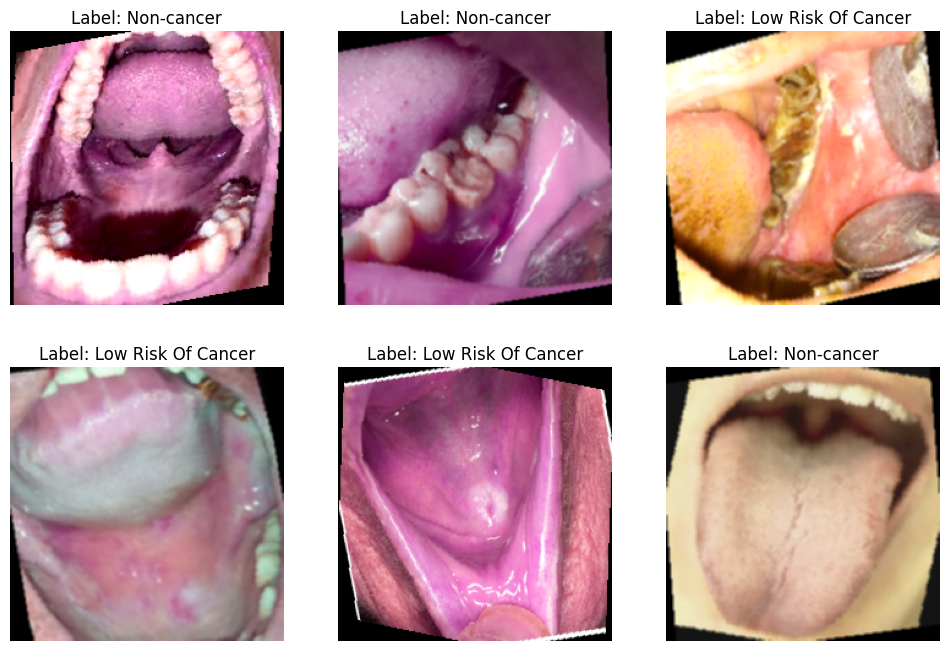

In [ ]:
for images, labels in test_dataloader:
    show_images(images, labels, num_images=6)  # Show 6 images
    break  # Break after the first batch to only display 6 images

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import copy

# Define the ResNet Model class
class ResNetModel(nn.Module):
    def __init__(self, num_classes):
        super(ResNetModel, self).__init__()
        # Load the pre-trained ResNet-18 model
        self.model = models.resnet18(pretrained=True)
        # Replace the final fully connected layer to match the number of output classes
        self.model.fc = nn.Linear(self.model.fc.in_features, num_classes)

    def forward(self, x):
        return self.model(x)

# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Number of classes (assuming you have a dictionary or mapping for categories)
num_classes = 2  # Replace with your actual number of categories

# Instantiate the model
model_resnet18 = ResNetModel(num_classes=num_classes).to(device)

# Loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_resnet18.parameters(), lr=0.001)

# Early Stopping parameters
patience = 5  # Number of epochs to wait before stopping if no improvement
best_loss = float('inf')  # Initialize the best loss to infinity
best_model_wts = copy.deepcopy(model_resnet18.state_dict())  # Copy initial model weights
patience_counter = 0  # Counter to keep track of epochs with no improvement

# Training loop with Early Stopping
num_epochs = 50  # Set a larger number of epochs to allow early stopping to work
for epoch in range(num_epochs):
    model_resnet18.train()
    running_train_loss = 0.0

    for images, labels in train_dataloader:
        images, labels = images.to(device), labels.to(device)

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model_resnet18(images)
        loss = criterion(outputs, labels)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        running_train_loss += loss.item()

    # Validation phase
    model_resnet18.eval()
    running_valid_loss = 0.0
    with torch.no_grad():
        for images, labels in val_dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model_resnet18(images)
            loss = criterion(outputs, labels)
            running_valid_loss += loss.item()

    # Calculate average losses
    avg_train_loss = running_train_loss / len(train_dataloader)
    avg_valid_loss = running_valid_loss / len(val_dataloader)

    # Print losses for the current epoch
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_valid_loss:.4f}')

    # Early Stopping logic
    if avg_valid_loss < best_loss:
        best_loss = avg_valid_loss
        best_model_wts = copy.deepcopy(model_resnet18.state_dict())
        patience_counter = 0  # Reset the counter if validation loss improves
    else:
        patience_counter += 1
        print(f'Early stopping counter: {patience_counter}/{patience}')
        if patience_counter >= patience:
            print("Early stopping triggered")
            break

# Load the best model weights before saving
model_resnet18.load_state_dict(best_model_wts)

# Save the trained model
torch.save(model_resnet18.state_dict(), 'resnet_model_best.pth')

# Model summary (optional)
from torchsummary import summary
summary(model_resnet18, (3, 224, 224))  # ResNet expects 224x224 input images


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 181MB/s]


Epoch [1/50], Train Loss: 0.3926, Val Loss: 0.2504
Epoch [2/50], Train Loss: 0.2415, Val Loss: 0.2376
Epoch [3/50], Train Loss: 0.1917, Val Loss: 0.2806
Early stopping counter: 1/5
Epoch [4/50], Train Loss: 0.1558, Val Loss: 0.2347
Epoch [5/50], Train Loss: 0.1141, Val Loss: 0.2167
Epoch [6/50], Train Loss: 0.1004, Val Loss: 0.2733
Early stopping counter: 1/5
Epoch [7/50], Train Loss: 0.0945, Val Loss: 0.1612
Epoch [8/50], Train Loss: 0.0774, Val Loss: 0.2857
Early stopping counter: 1/5
Epoch [9/50], Train Loss: 0.0528, Val Loss: 0.3525
Early stopping counter: 2/5
Epoch [10/50], Train Loss: 0.0569, Val Loss: 0.3345
Early stopping counter: 3/5
Epoch [11/50], Train Loss: 0.0627, Val Loss: 0.6220
Early stopping counter: 4/5
Epoch [12/50], Train Loss: 0.0522, Val Loss: 0.6122
Early stopping counter: 5/5
Early stopping triggered
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 6

Confusion Matrix:
[[211  17]
 [ 16 250]]


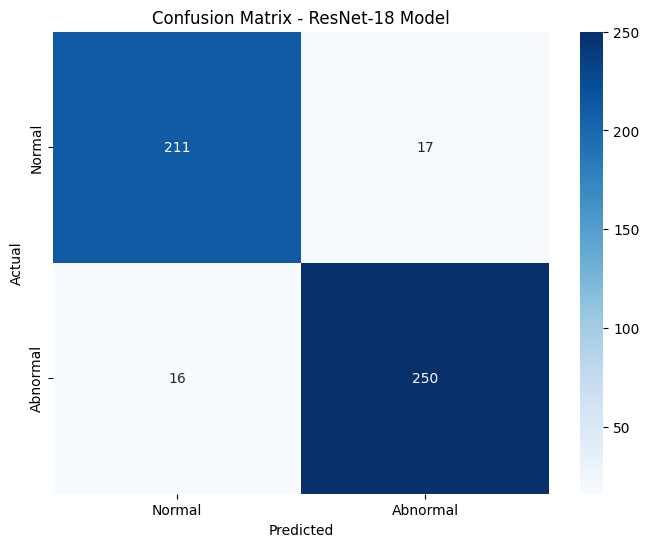

Classification Report:
              precision    recall  f1-score   support

      Normal       0.93      0.93      0.93       228
    Abnormal       0.94      0.94      0.94       266

    accuracy                           0.93       494
   macro avg       0.93      0.93      0.93       494
weighted avg       0.93      0.93      0.93       494



In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import torch

# Lists to store all true labels and predictions
all_labels = []
all_predictions = []

# Perform evaluation to get predictions for the entire test set
model_resnet18.eval()
with torch.no_grad():
    for images, labels in test_dataloader:
        images, labels = images.to(device), labels.to(device)
        outputs = model_resnet18(images)
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Define the categories
categories = ["Normal", "Abnormal"]

# Confusion Matrix
cm1 = confusion_matrix(all_labels, all_predictions)
print("Confusion Matrix:")
print(cm1)

# Plot Confusion Matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm1, annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - ResNet-18 Model')
plt.show()

# Classification Report
print("Classification Report:")
print(classification_report(all_labels, all_predictions, target_names=categories))

In [ ]:
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import copy

# Define MobileNetV2 Model
class MobileNetV2Model(nn.Module):
    def __init__(self, num_classes):
        super(MobileNetV2Model, self).__init__()
        self.model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.DEFAULT)
        self.model.classifier[1] = nn.Linear(self.model.classifier[1].in_features, num_classes)

    def forward(self, x):
        return self.model(x)

# Instantiate the model
model_mobilenetv2 = MobileNetV2Model(num_classes=num_classes).to(device)

# Loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_mobilenetv2.parameters(), lr=0.001)

# Training loop with Early Stopping (Same as above, replace model_resnet50 with model_mobilenetv2)
num_epochs = 50
best_loss = float('inf')
best_model_wts = copy.deepcopy(model_mobilenetv2.state_dict())
patience_counter = 0

for epoch in range(num_epochs):
    model_mobilenetv2.train()
    running_train_loss = 0.0

    for images, labels in train_dataloader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model_mobilenetv2(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item()

    model_mobilenetv2.eval()
    running_valid_loss = 0.0
    with torch.no_grad():
        for images, labels in val_dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model_mobilenetv2(images)
            loss = criterion(outputs, labels)
            running_valid_loss += loss.item()

    avg_train_loss = running_train_loss / len(train_dataloader)
    avg_valid_loss = running_valid_loss / len(val_dataloader)
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_valid_loss:.4f}')

    if avg_valid_loss < best_loss:
        best_loss = avg_valid_loss
        best_model_wts = copy.deepcopy(model_mobilenetv2.state_dict())
        patience_counter = 0
    else:
        patience_counter += 1
        print(f'Early stopping counter: {patience_counter}/{patience}')
        if patience_counter >= patience:
            print("Early stopping triggered")
            break

model_mobilenetv2.load_state_dict(best_model_wts)
torch.save(model_mobilenetv2.state_dict(), 'mobilenetv2_best.pth')

Downloading: "https://download.pytorch.org/models/mobilenet_v2-7ebf99e0.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-7ebf99e0.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 108MB/s] 


Epoch [1/50], Train Loss: 0.2727, Val Loss: 0.1885
Epoch [2/50], Train Loss: 0.1065, Val Loss: 0.1376
Epoch [3/50], Train Loss: 0.0740, Val Loss: 0.1108
Epoch [4/50], Train Loss: 0.0492, Val Loss: 0.2801
Early stopping counter: 1/5
Epoch [5/50], Train Loss: 0.0912, Val Loss: 0.1377
Early stopping counter: 2/5
Epoch [6/50], Train Loss: 0.0632, Val Loss: 0.0974
Epoch [7/50], Train Loss: 0.0175, Val Loss: 0.0619
Epoch [8/50], Train Loss: 0.0270, Val Loss: 0.0890
Early stopping counter: 1/5
Epoch [9/50], Train Loss: 0.0695, Val Loss: 0.1260
Early stopping counter: 2/5
Epoch [10/50], Train Loss: 0.0223, Val Loss: 0.1533
Early stopping counter: 3/5
Epoch [11/50], Train Loss: 0.0180, Val Loss: 0.1667
Early stopping counter: 4/5
Epoch [12/50], Train Loss: 0.0340, Val Loss: 0.1867
Early stopping counter: 5/5
Early stopping triggered


Confusion Matrix for MobileNetV2:
[[213  15]
 [ 10 256]]


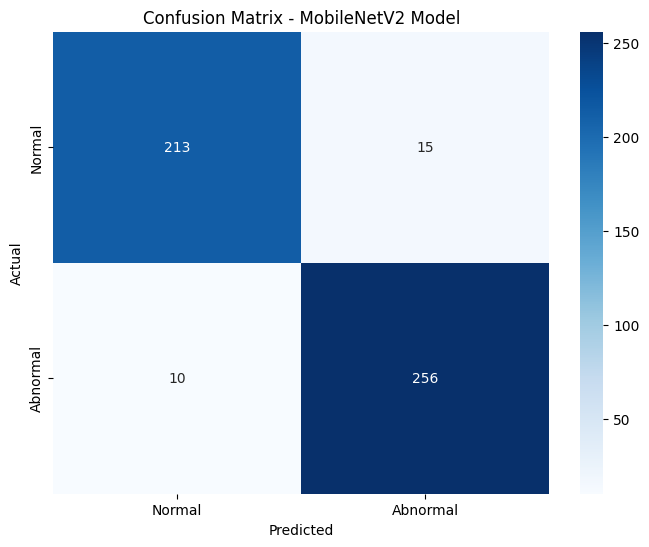

Classification Report for MobileNetV2:
              precision    recall  f1-score   support

      Normal       0.96      0.93      0.94       228
    Abnormal       0.94      0.96      0.95       266

    accuracy                           0.95       494
   macro avg       0.95      0.95      0.95       494
weighted avg       0.95      0.95      0.95       494



In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import torch

# Lists to store all true labels and predictions
all_labels = []
all_predictions = []

# Perform evaluation to get predictions for the entire test set
model_mobilenetv2.eval()
with torch.no_grad():
    for images, labels in test_dataloader:
        images, labels = images.to(device), labels.to(device)
        outputs = model_mobilenetv2(images)
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Define the categories (assuming binary classification: Normal and Abnormal)
categories = ["Normal", "Abnormal"]

# Confusion Matrix for MobileNetV2
cm2 = confusion_matrix(all_labels, all_predictions)
print("Confusion Matrix for MobileNetV2:")
print(cm2)

# Plot Confusion Matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm2, annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - MobileNetV2 Model')
plt.show()

# Classification Report
print("Classification Report for MobileNetV2:")
print(classification_report(all_labels, all_predictions, target_names=categories))

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


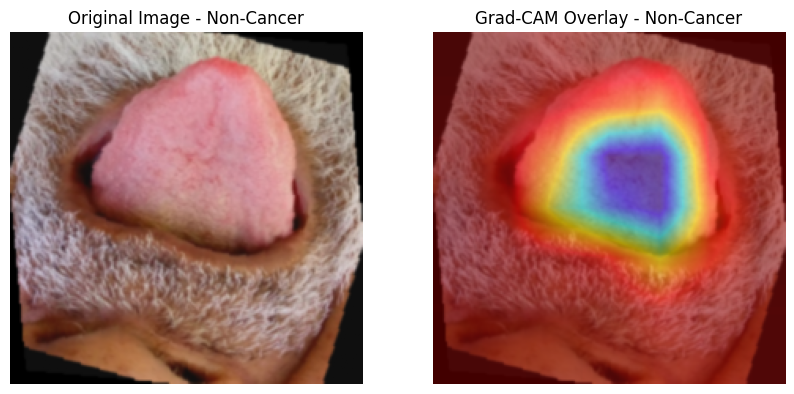

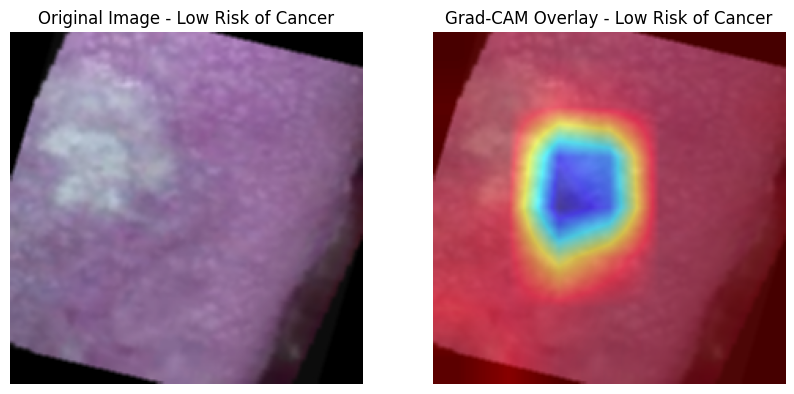

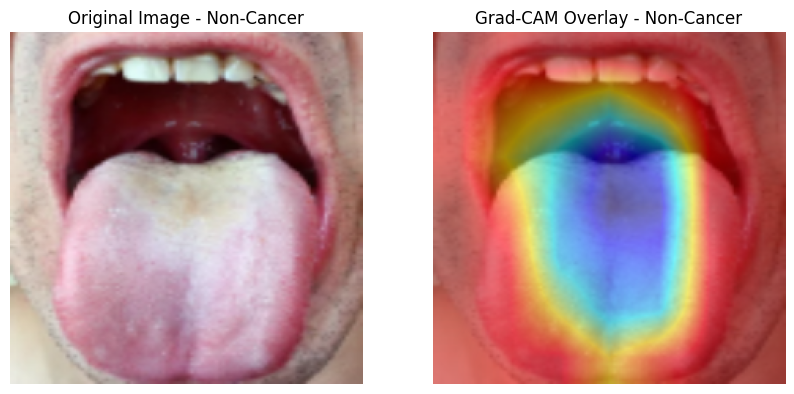

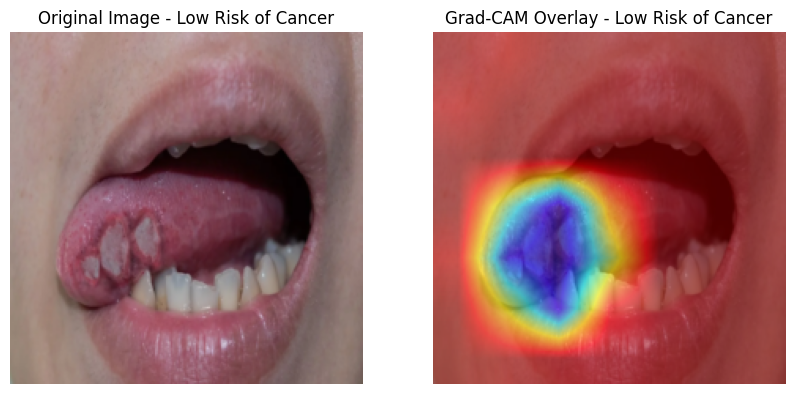

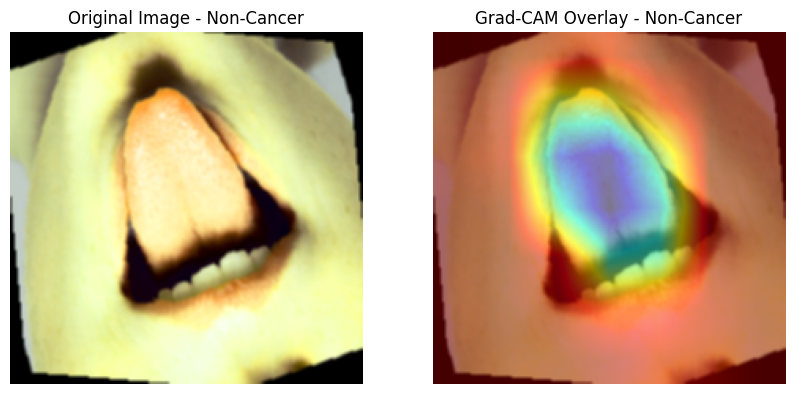

...

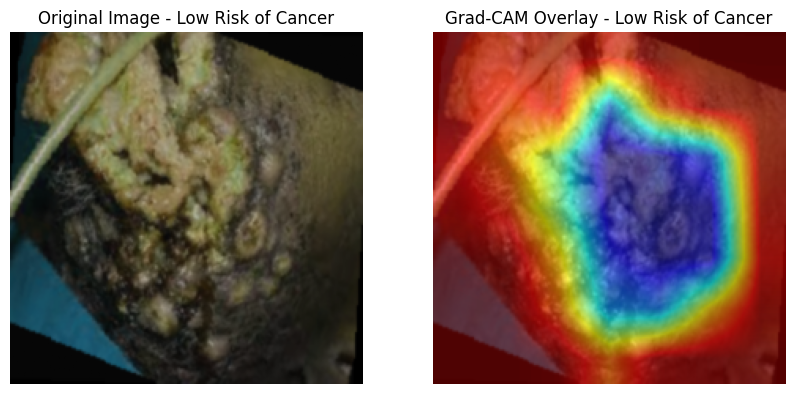

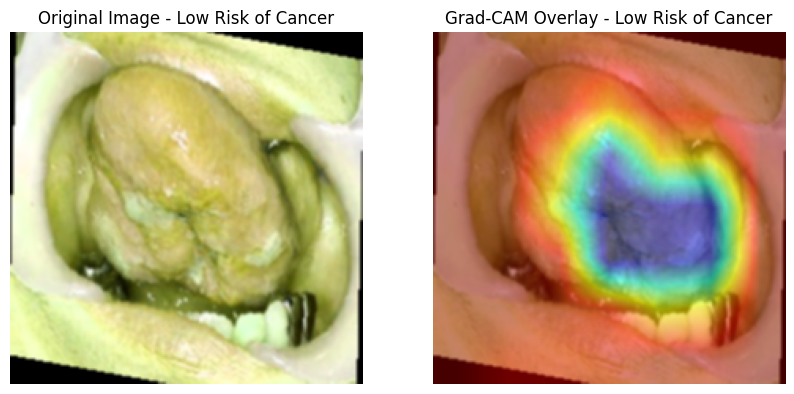

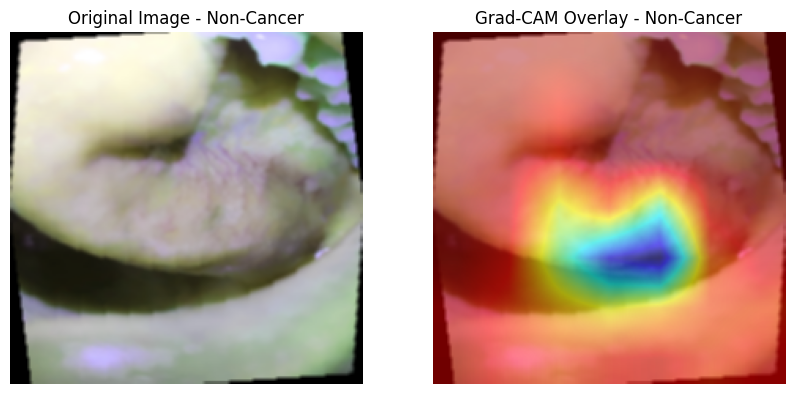

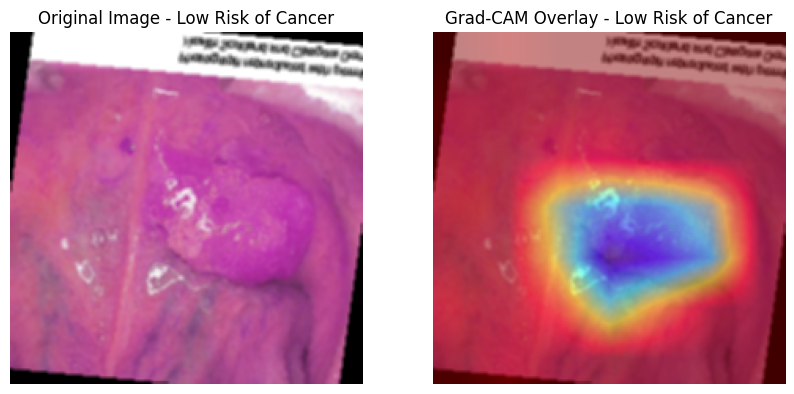

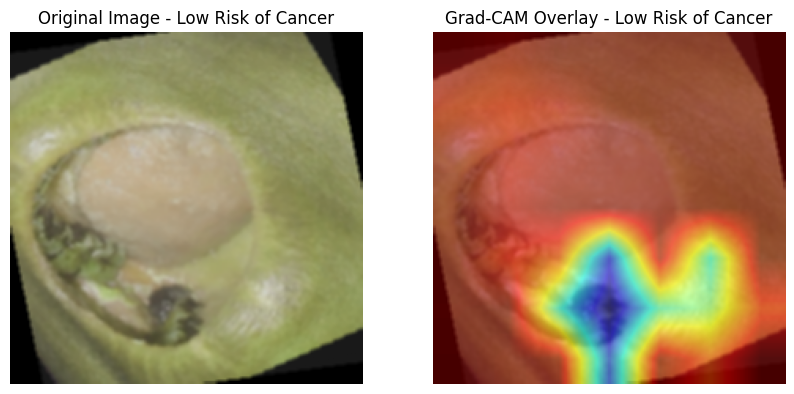

In [ ]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from torchvision import models

# Define Grad-CAM class
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.model.eval()
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        # Hook the gradients and activations of the target layer
        target_layer.register_forward_hook(self.save_activation)
        target_layer.register_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def __call__(self, input_tensor, class_idx=None):
        # Forward pass
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = output.argmax().item()

        # Backward pass
        self.model.zero_grad()
        output[:, class_idx].backward()

        # Compute Grad-CAM
        gradients = self.gradients[0].cpu().data.numpy()
        activations = self.activations[0].cpu().data.numpy()

        weights = np.mean(gradients, axis=(1, 2))  # Global average pooling on gradients
        cam = np.zeros(activations.shape[1:], dtype=np.float32)

        for i, w in enumerate(weights):
            cam += w * activations[i]

        cam = np.maximum(cam, 0)  # Apply ReLU to keep only positive values
        cam = cv2.resize(cam, (input_tensor.shape[2], input_tensor.shape[3]))
        cam = cam - np.min(cam)
        cam = cam / np.max(cam)
        return cam

# Load the MobileNetV2 model and set to evaluation mode
model = model_mobilenetv2
target_layer = model.model.features[-1]  # Last convolutional layer in MobileNetV2

# Initialize Grad-CAM
grad_cam = GradCAM(model, target_layer)

# Define class names for display
class_names = ["Non-Cancer", "Low Risk of Cancer"]

# Visualize original and Grad-CAM overlay for all images in the batch with labels
def visualize_cam_full_batch(dataloader):
    images, labels = next(iter(dataloader))  # Get a batch from the test set
    images, labels = images.to(device), labels.to(device)

    # Process each image in the batch
    for i in range(len(images)):
        image = images[i].unsqueeze(0)  # Select a single image
        cam = grad_cam(image)

        # Convert image tensor to numpy format for visualization
        original_image = image[0].permute(1, 2, 0).cpu().numpy()  # Convert from CHW to HWC format
        original_image = np.clip(original_image, 0, 1)  # Clip values to [0, 1]

        # Create heatmap and overlay with original image
        heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
        heatmap = np.float32(heatmap) / 255
        cam_image = heatmap + original_image
        cam_image = cam_image / np.max(cam_image)

        # Get the label for the current image
        label_text = class_names[labels[i].item()]

        # Plot original and Grad-CAM images side by side with label
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        # Original Image
        axes[0].imshow(original_image)
        axes[0].set_title(f"Original Image - {label_text}")
        axes[0].axis('off')

        # Grad-CAM Image
        axes[1].imshow(cam_image)
        axes[1].set_title(f"Grad-CAM Overlay - {label_text}")
        axes[1].axis('off')

        plt.show()

# Call the function to visualize all images in the batch
visualize_cam_full_batch(test_dataloader)

# ON REAL DATASET

In [ ]:
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import copy

# Define MobileNetV3 Model
class MobileNetV3Model(nn.Module):
    def __init__(self, num_classes):
        super(MobileNetV3Model, self).__init__()
        self.model = models.mobilenet_v3_large(weights=models.MobileNet_V3_Large_Weights.DEFAULT)
        self.model.classifier[3] = nn.Linear(self.model.classifier[3].in_features, num_classes)

    def forward(self, x):
        return self.model(x)

# Instantiate the model
model_mobilenetv3 = MobileNetV3Model(num_classes=num_classes).to(device)

# Loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_mobilenetv3.parameters(), lr=0.001)

# Training loop with Early Stopping
num_epochs = 50
patience = 5  # Define patience for early stopping
best_loss = float('inf')
best_model_wts = copy.deepcopy(model_mobilenetv3.state_dict())
patience_counter = 0

for epoch in range(num_epochs):
    model_mobilenetv3.train()
    running_train_loss = 0.0

    for images, labels in train_dataloader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model_mobilenetv3(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item()

    model_mobilenetv3.eval()
    running_valid_loss = 0.0
    with torch.no_grad():
        for images, labels in val_dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model_mobilenetv3(images)
            loss = criterion(outputs, labels)
            running_valid_loss += loss.item()

    avg_train_loss = running_train_loss / len(train_dataloader)
    avg_valid_loss = running_valid_loss / len(val_dataloader)
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_valid_loss:.4f}')

    if avg_valid_loss < best_loss:
        best_loss = avg_valid_loss
        best_model_wts = copy.deepcopy(model_mobilenetv3.state_dict())
        patience_counter = 0
    else:
        patience_counter += 1
        print(f'Early stopping counter: {patience_counter}/{patience}')
        if patience_counter >= patience:
            print("Early stopping triggered")
            break

model_mobilenetv3.load_state_dict(best_model_wts)
torch.save(model_mobilenetv3.state_dict(), 'mobilenetv3_best.pth')

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-5c1a4163.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-5c1a4163.pth
100%|██████████| 21.1M/21.1M [00:00<00:00, 58.2MB/s]


Epoch [1/50], Train Loss: 0.2580, Val Loss: 5.9405
Epoch [2/50], Train Loss: 0.1042, Val Loss: 2.3751
Epoch [3/50], Train Loss: 0.0697, Val Loss: 0.9291
Epoch [4/50], Train Loss: 0.0466, Val Loss: 0.3457
Epoch [5/50], Train Loss: 0.0466, Val Loss: 0.3644
Early stopping counter: 1/5
Epoch [6/50], Train Loss: 0.0541, Val Loss: 0.2266
Epoch [7/50], Train Loss: 0.0397, Val Loss: 0.1254
Epoch [8/50], Train Loss: 0.0153, Val Loss: 0.4344
Early stopping counter: 1/5
Epoch [9/50], Train Loss: 0.0389, Val Loss: 0.2073
Early stopping counter: 2/5
Epoch [10/50], Train Loss: 0.0302, Val Loss: 0.6416
Early stopping counter: 3/5
Epoch [11/50], Train Loss: 0.0412, Val Loss: 0.1653
Early stopping counter: 4/5
Epoch [12/50], Train Loss: 0.0385, Val Loss: 0.9308
Early stopping counter: 5/5
Early stopping triggered


Confusion Matrix for MobileNetV3:
[[220   8]
 [  4 262]]


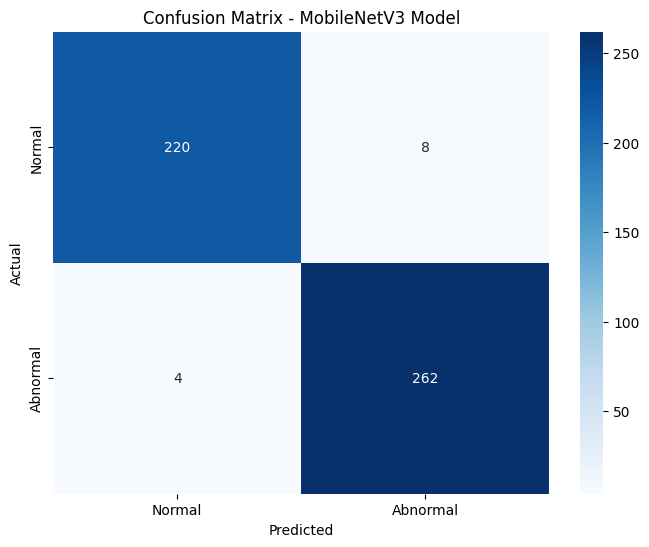

Classification Report for MobileNetV3:
              precision    recall  f1-score   support

      Normal       0.98      0.96      0.97       228
    Abnormal       0.97      0.98      0.98       266

    accuracy                           0.98       494
   macro avg       0.98      0.97      0.98       494
weighted avg       0.98      0.98      0.98       494



In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import torch

# Lists to store all true labels and predictions
all_labels = []
all_predictions = []

# Perform evaluation to get predictions for the entire test set
model_mobilenetv3.eval()  # Change to MobileNetV3 model
with torch.no_grad():
    for images, labels in test_dataloader:
        images, labels = images.to(device), labels.to(device)
        outputs = model_mobilenetv3(images)  # Change to MobileNetV3 model
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Define the categories (assuming binary classification: Normal and Abnormal)
categories = ["Normal", "Abnormal"]

# Confusion Matrix for MobileNetV3
cm3 = confusion_matrix(all_labels, all_predictions)
print("Confusion Matrix for MobileNetV3:")
print(cm3)

# Plot Confusion Matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm3, annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - MobileNetV3 Model')
plt.show()

# Classification Report
print("Classification Report for MobileNetV3:")
print(classification_report(all_labels, all_predictions, target_names=categories))

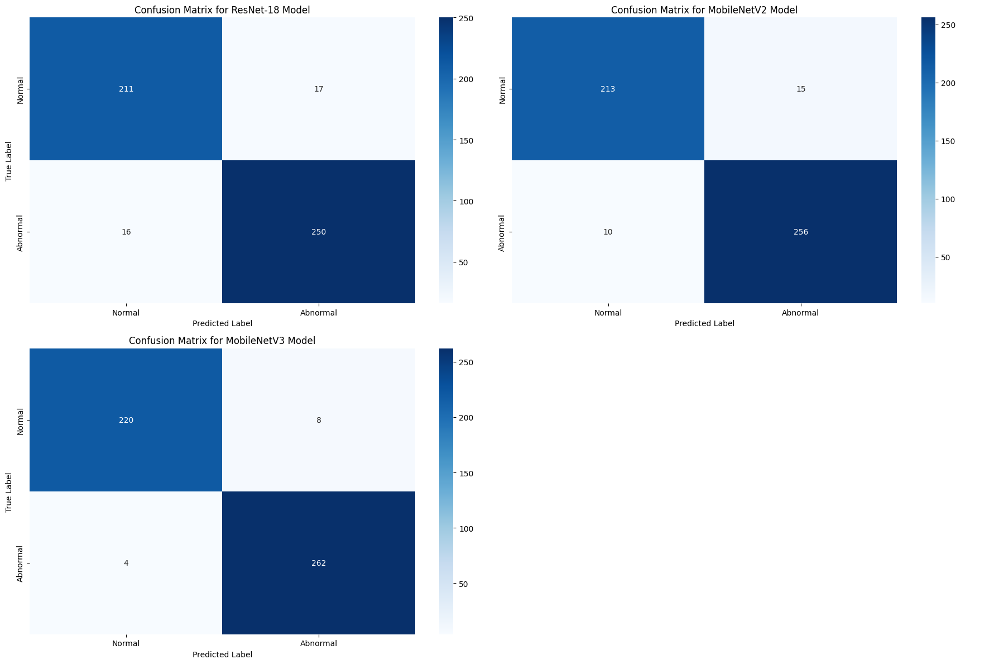

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report

# Define categories
categories = ['Normal', 'Abnormal']

# Create figure and subplots with 2 matrices on the top row and 1 in the center of the bottom row
fig, axes = plt.subplots(2, 2, figsize=(18, 12))  # Adjust size to accommodate the layout

# Plot each confusion matrix with respective titles
sns.heatmap(cm1, ax=axes[0, 0], annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
axes[0, 0].set_title("Confusion Matrix for ResNet-18 Model")
axes[0, 0].set_xlabel('Predicted Label')
axes[0, 0].set_ylabel('True Label')

sns.heatmap(cm2, ax=axes[0, 1], annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
axes[0, 1].set_title("Confusion Matrix for MobileNetV2 Model")
axes[0, 1].set_xlabel('Predicted Label')

# Plot the third matrix in the center of the bottom row
sns.heatmap(cm3, ax=axes[1, 0], annot=True, fmt='d', cmap='Blues', xticklabels=categories, yticklabels=categories)
axes[1, 0].set_title("Confusion Matrix for MobileNetV3 Model")
axes[1, 0].set_xlabel('Predicted Label')
axes[1, 0].set_ylabel('True Label')

# Turn off the unused subplot (axes[1, 1]) in the bottom row
axes[1, 1].axis('off')

# Rotate x-axis labels horizontally and y-axis labels vertically for all subplots
for ax in [axes[0, 0], axes[0, 1], axes[1, 0]]:
    ax.set_xticklabels(categories, rotation=0, ha='center')
    ax.set_yticklabels(categories, rotation=90, va='center')

# Use a tight layout to ensure labels fit neatly
plt.tight_layout()

# Save the figure with high resolution for clear visualization in documentation
plt.savefig('adjusted_confusion_matrices.png', dpi=300)

# Display the plot
plt.show()

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


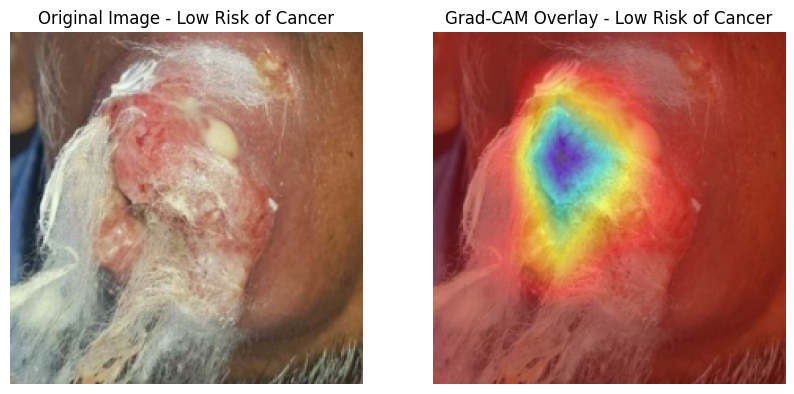

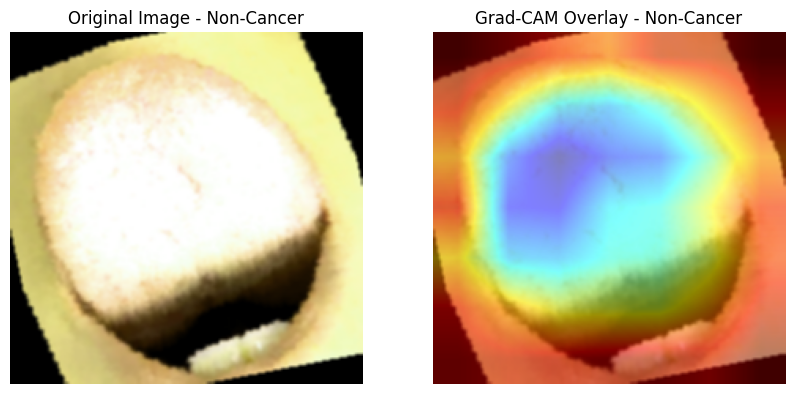

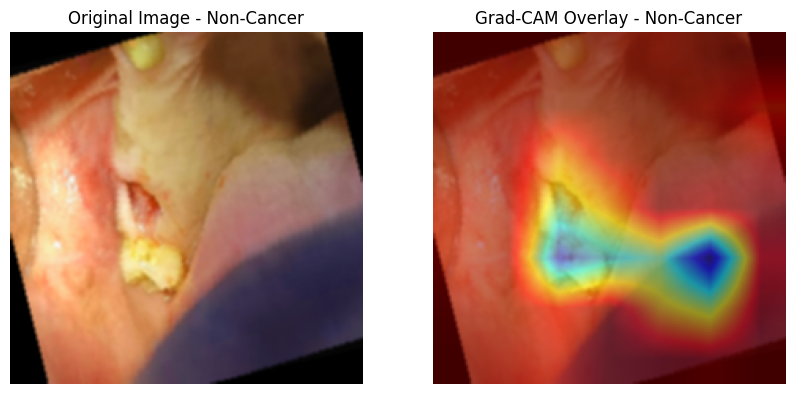

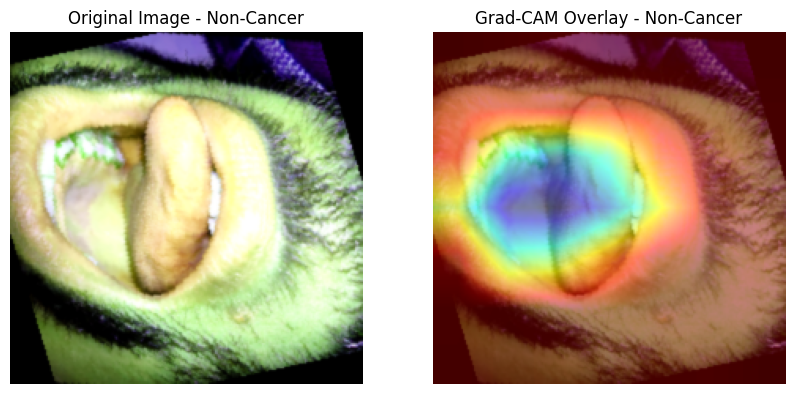

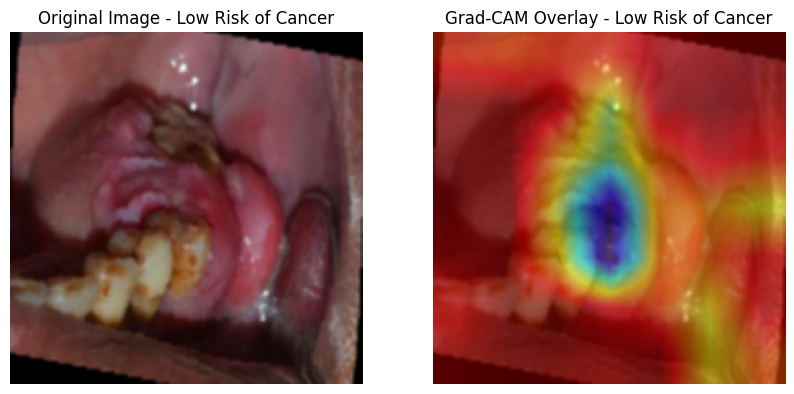

...

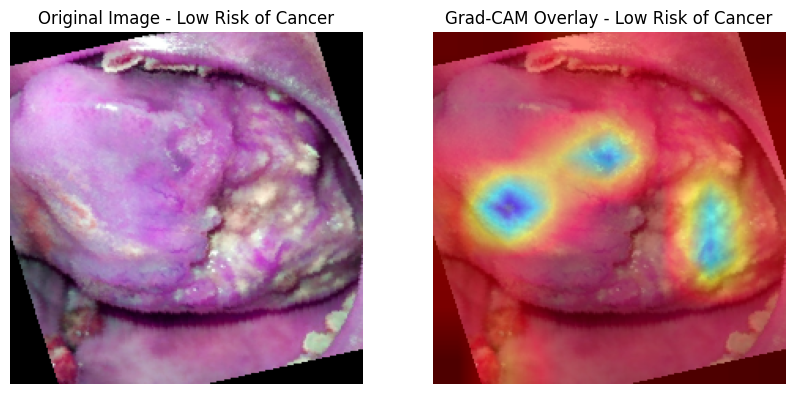

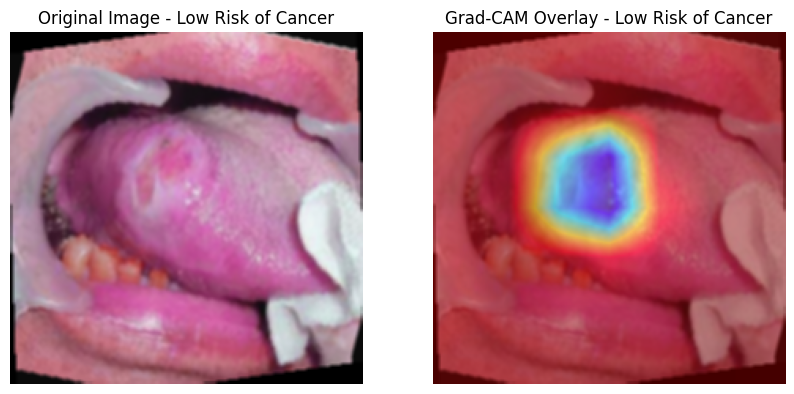

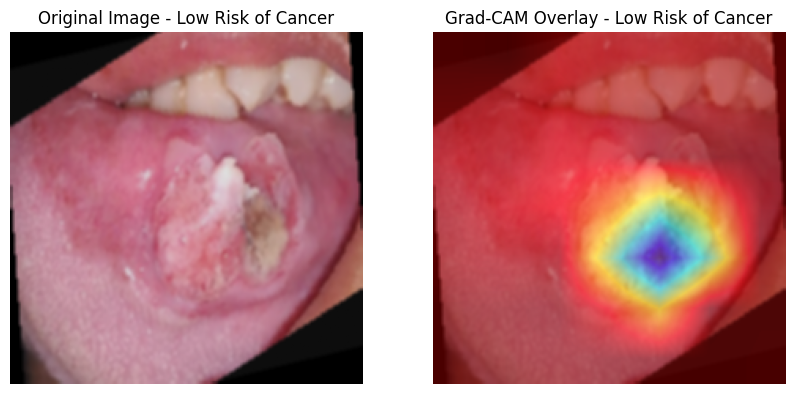

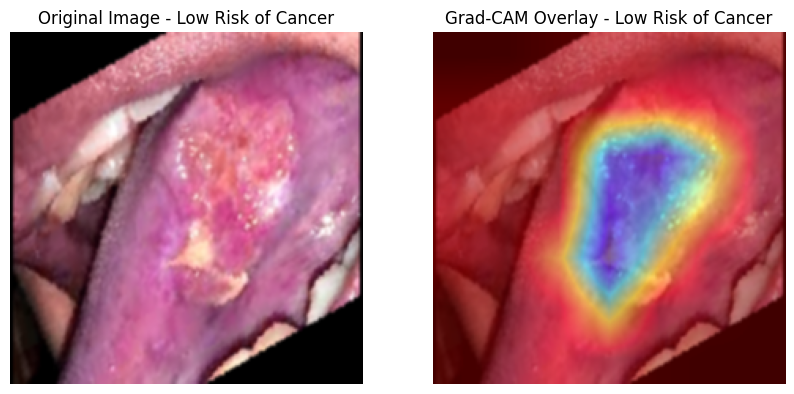

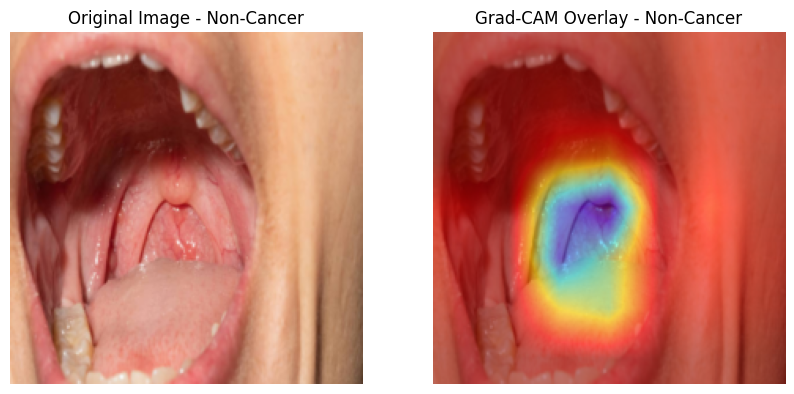

In [ ]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from torchvision import models

# Define Grad-CAM class
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.model.eval()
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        # Hook the gradients and activations of the target layer
        target_layer.register_forward_hook(self.save_activation)
        target_layer.register_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def __call__(self, input_tensor, class_idx=None):
        # Forward pass
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = output.argmax().item()

        # Backward pass
        self.model.zero_grad()
        output[:, class_idx].backward()

        # Compute Grad-CAM
        gradients = self.gradients[0].cpu().data.numpy()
        activations = self.activations[0].cpu().data.numpy()

        weights = np.mean(gradients, axis=(1, 2))  # Global average pooling on gradients
        cam = np.zeros(activations.shape[1:], dtype=np.float32)

        for i, w in enumerate(weights):
            cam += w * activations[i]

        cam = np.maximum(cam, 0)  # Apply ReLU to keep only positive values
        cam = cv2.resize(cam, (input_tensor.shape[2], input_tensor.shape[3]))
        cam = cam - np.min(cam)
        cam = cam / np.max(cam)
        return cam

# Load the MobileNetV2 model and set to evaluation mode
model = model_mobilenetv3
target_layer = model.model.features[-1]  # Last convolutional layer in MobileNetV2

# Initialize Grad-CAM
grad_cam = GradCAM(model, target_layer)

# Define class names for display
class_names = ["Non-Cancer", "Low Risk of Cancer"]

# Visualize original and Grad-CAM overlay for all images in the batch with labels
def visualize_cam_full_batch(dataloader):
    images, labels = next(iter(dataloader))  # Get a batch from the test set
    images, labels = images.to(device), labels.to(device)

    # Process each image in the batch
    for i in range(len(images)):
        image = images[i].unsqueeze(0)  # Select a single image
        cam = grad_cam(image)

        # Convert image tensor to numpy format for visualization
        original_image = image[0].permute(1, 2, 0).cpu().numpy()  # Convert from CHW to HWC format
        original_image = np.clip(original_image, 0, 1)  # Clip values to [0, 1]

        # Create heatmap and overlay with original image
        heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
        heatmap = np.float32(heatmap) / 255
        cam_image = heatmap + original_image
        cam_image = cam_image / np.max(cam_image)

        # Get the label for the current image
        label_text = class_names[labels[i].item()]

        # Plot original and Grad-CAM images side by side with label
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        # Original Image
        axes[0].imshow(original_image)
        axes[0].set_title(f"Original Image - {label_text}")
        axes[0].axis('off')

        # Grad-CAM Image
        axes[1].imshow(cam_image)
        axes[1].set_title(f"Grad-CAM Overlay - {label_text}")
        axes[1].axis('off')

        plt.show()

# Call the function to visualize all images in the batch
visualize_cam_full_batch(test_dataloader)

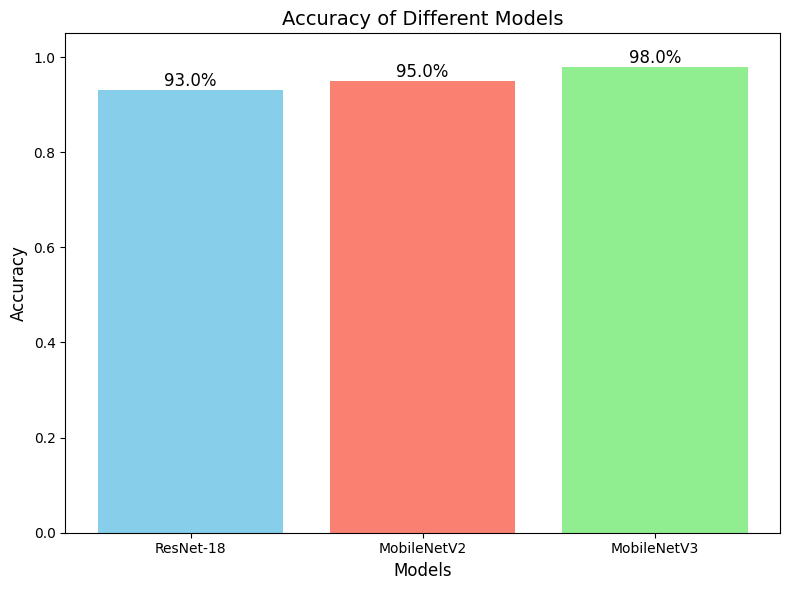

In [ ]:
import matplotlib.pyplot as plt

# Define model names and their corresponding accuracies
model_names = ['ResNet-18', 'MobileNetV2', 'MobileNetV3']
accuracies = [0.93, 0.95, 0.98]  # Accuracy values for each model

# Plotting
plt.figure(figsize=(8, 6))
bars = plt.bar(model_names, accuracies, color=['skyblue', 'salmon', 'lightgreen'])

# Add data labels above each bar
for bar, accuracy in zip(bars, accuracies):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(),
             f'{accuracy * 100:.1f}%', ha='center', va='bottom', fontsize=12)

# Set plot labels and title
plt.xlabel('Models', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.title('Accuracy of Different Models', fontsize=14)
plt.ylim(0, 1.05)  # Ensure y-axis range covers the highest accuracy

# Show plot
plt.tight_layout()
plt.show()